In [5]:
#Install Pytorch if it is not already installed
!pip install torch

     |████████████████████████████████| 173.9 MB 44.6 MB/s eta 0:00:01
     |████████████████████████████████| 3.3 MB 8.9 MB/s eta 0:00:01
     |████████████████████████████████| 15.6 MB 19.0 MB/s eta 0:00:01
     |████████████████████████████████| 42 kB 4.1 MB/s  eta 0:00:01
     |████████████████████████████████| 1.0 MB 5.2 MB/s eta 0:00:01
     |████████████████████████████████| 10.6 MB 23.6 MB/s eta 0:00:01
     |████████████████████████████████| 57 kB 11.4 MB/s eta 0:00:01
     |████████████████████████████████| 65 kB 11.3 MB/s eta 0:00:01
     |████████████████████████████████| 129 kB 32.2 MB/s eta 0:00:01
     |████████████████████████████████| 462 kB 7.2 MB/s eta 0:00:01
     |████████████████████████████████| 781 kB 51.8 MB/s eta 0:00:01
     |████████████████████████████████| 97 kB 16.8 MB/s eta 0:00:01
     |████████████████████████████████| 136 kB 21.5 MB/s eta 0:00:01
     |████████████████████████████████| 155 kB 23.5 MB/s eta 0:00:01
     |███████████████████████████████

In [40]:
from __future__ import print_function
#%matplotlib inline
import argparse
import os
import random
import torch
import torchvision
import torchvision.transforms as transforms
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
import math


# Set random seed for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  999


In [41]:
# Root directory for dataset
#dataroot = ""

# Number of workers for dataloader
workers = 2

# Batch size during training
batch_size = 128

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 0

In [42]:
dataset = torchvision.datasets.ImageFolder(root='celeba_gan',transform=transforms.ToTensor())
trainset, testset = torch.utils.data.random_split(dataset,[math.floor(0.8*len(dataset)),math.ceil(0.2*len(dataset))])

trainloader = torch.utils.data.DataLoader(trainset, batch_size=32,
                                          shuffle=True, num_workers=0)
trainloader = torch.utils.data.DataLoader(testset, batch_size=32,
                                          shuffle=True, num_workers=0)
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

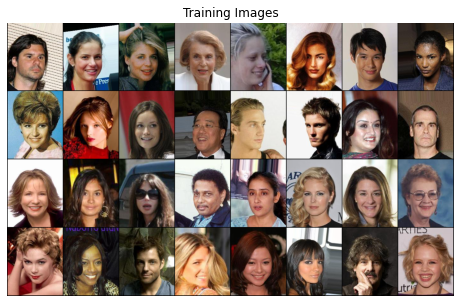

In [43]:
real_batch = next(iter(trainloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [44]:
# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [45]:
# Generator

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)

In [46]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [47]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [48]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [49]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [50]:
# Training Loop

# Number of training epochs
num_epochs = 30

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(testloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Add the gradients from the all-real and all-fake batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(testloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(testloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...
[0/30][0/2500]	Loss_D: 1.3987	Loss_G: 10.9013	D(x): 0.5482	D(G(z)): 0.5173 / 0.0001
[0/30][50/2500]	Loss_D: 0.1491	Loss_G: 8.7857	D(x): 0.8895	D(G(z)): 0.0100 / 0.0005
[0/30][100/2500]	Loss_D: 0.0423	Loss_G: 7.1083	D(x): 0.9790	D(G(z)): 0.0203 / 0.0010
[0/30][150/2500]	Loss_D: 0.0464	Loss_G: 5.9809	D(x): 0.9660	D(G(z)): 0.0103 / 0.0043
[0/30][200/2500]	Loss_D: 3.2938	Loss_G: 16.4436	D(x): 0.2988	D(G(z)): 0.0000 / 0.0000
[0/30][250/2500]	Loss_D: 0.1775	Loss_G: 9.8925	D(x): 0.8639	D(G(z)): 0.0002 / 0.0001
[0/30][300/2500]	Loss_D: 0.7885	Loss_G: 6.9822	D(x): 0.6644	D(G(z)): 0.1531 / 0.0067
[0/30][350/2500]	Loss_D: 0.0196	Loss_G: 4.7382	D(x): 0.9979	D(G(z)): 0.0173 / 0.0388
[0/30][400/2500]	Loss_D: 0.3712	Loss_G: 4.1566	D(x): 0.7969	D(G(z)): 0.0575 / 0.0193
[0/30][450/2500]	Loss_D: 0.0404	Loss_G: 4.0455	D(x): 0.9842	D(G(z)): 0.0233 / 0.0404
[0/30][500/2500]	Loss_D: 1.1570	Loss_G: 2.1968	D(x): 0.6260	D(G(z)): 0.1085 / 0.1344
[0/30][550/2500]	Loss_D: 0.3440	Loss_G: 

[1/30][2300/2500]	Loss_D: 0.8308	Loss_G: 2.1601	D(x): 0.5453	D(G(z)): 0.1351 / 0.1242
[1/30][2350/2500]	Loss_D: 1.5241	Loss_G: 3.1136	D(x): 0.4740	D(G(z)): 0.1187 / 0.0724
[1/30][2400/2500]	Loss_D: 0.3242	Loss_G: 3.1377	D(x): 0.9233	D(G(z)): 0.1919 / 0.0477
[1/30][2450/2500]	Loss_D: 0.6980	Loss_G: 2.7449	D(x): 0.9992	D(G(z)): 0.3957 / 0.0751
[2/30][0/2500]	Loss_D: 4.1228	Loss_G: 1.8390	D(x): 0.0635	D(G(z)): 0.1255 / 0.2043
[2/30][50/2500]	Loss_D: 1.0612	Loss_G: 1.8754	D(x): 0.5798	D(G(z)): 0.3295 / 0.1570
[2/30][100/2500]	Loss_D: 1.6377	Loss_G: 1.1246	D(x): 0.4950	D(G(z)): 0.4761 / 0.3530
[2/30][150/2500]	Loss_D: 1.3762	Loss_G: 2.3429	D(x): 0.3782	D(G(z)): 0.1479 / 0.1125
[2/30][200/2500]	Loss_D: 0.8699	Loss_G: 3.6167	D(x): 0.5663	D(G(z)): 0.1212 / 0.0544
[2/30][250/2500]	Loss_D: 1.4084	Loss_G: 1.7510	D(x): 0.5488	D(G(z)): 0.4492 / 0.1782
[2/30][300/2500]	Loss_D: 0.8687	Loss_G: 2.5109	D(x): 0.8196	D(G(z)): 0.4547 / 0.0992
[2/30][350/2500]	Loss_D: 0.9848	Loss_G: 2.9488	D(x): 0.4937	D(G(

[3/30][2100/2500]	Loss_D: 0.4511	Loss_G: 3.1397	D(x): 0.9496	D(G(z)): 0.2844 / 0.0619
[3/30][2150/2500]	Loss_D: 1.4649	Loss_G: 3.2038	D(x): 0.3632	D(G(z)): 0.0052 / 0.0470
[3/30][2200/2500]	Loss_D: 0.2811	Loss_G: 3.2739	D(x): 0.8335	D(G(z)): 0.0772 / 0.0426
[3/30][2250/2500]	Loss_D: 0.2119	Loss_G: 2.9917	D(x): 0.9904	D(G(z)): 0.1766 / 0.0622
[3/30][2300/2500]	Loss_D: 0.5396	Loss_G: 5.6054	D(x): 0.9788	D(G(z)): 0.3940 / 0.0038
[3/30][2350/2500]	Loss_D: 0.6796	Loss_G: 3.9602	D(x): 0.9953	D(G(z)): 0.3587 / 0.0265
[3/30][2400/2500]	Loss_D: 0.9290	Loss_G: 3.4728	D(x): 0.9968	D(G(z)): 0.5591 / 0.0333
[3/30][2450/2500]	Loss_D: 0.6328	Loss_G: 3.6091	D(x): 1.0000	D(G(z)): 0.3980 / 0.0338
[4/30][0/2500]	Loss_D: 1.6044	Loss_G: 2.9761	D(x): 0.3243	D(G(z)): 0.0167 / 0.0758
[4/30][50/2500]	Loss_D: 0.9463	Loss_G: 3.4886	D(x): 0.4137	D(G(z)): 0.0120 / 0.0335
[4/30][100/2500]	Loss_D: 0.6103	Loss_G: 3.6103	D(x): 0.8360	D(G(z)): 0.2943 / 0.0334
[4/30][150/2500]	Loss_D: 0.3938	Loss_G: 4.0975	D(x): 0.9999	

[5/30][1900/2500]	Loss_D: 0.1500	Loss_G: 5.3263	D(x): 0.8712	D(G(z)): 0.0082 / 0.0054
[5/30][1950/2500]	Loss_D: 0.0490	Loss_G: 4.2796	D(x): 0.9997	D(G(z)): 0.0470 / 0.0229
[5/30][2000/2500]	Loss_D: 1.7881	Loss_G: 2.9293	D(x): 0.2207	D(G(z)): 0.0223 / 0.0743
[5/30][2050/2500]	Loss_D: 0.5442	Loss_G: 4.6842	D(x): 0.6411	D(G(z)): 0.0099 / 0.0195
[5/30][2100/2500]	Loss_D: 1.0742	Loss_G: 4.7600	D(x): 0.9554	D(G(z)): 0.5385 / 0.0124
[5/30][2150/2500]	Loss_D: 0.9254	Loss_G: 3.4073	D(x): 0.5610	D(G(z)): 0.0304 / 0.0485
[5/30][2200/2500]	Loss_D: 0.0646	Loss_G: 4.6259	D(x): 0.9651	D(G(z)): 0.0282 / 0.0130
[5/30][2250/2500]	Loss_D: 0.0717	Loss_G: 4.0023	D(x): 0.9977	D(G(z)): 0.0660 / 0.0198
[5/30][2300/2500]	Loss_D: 0.6893	Loss_G: 2.8506	D(x): 0.6889	D(G(z)): 0.2272 / 0.0757
[5/30][2350/2500]	Loss_D: 0.3932	Loss_G: 4.6513	D(x): 1.0000	D(G(z)): 0.3009 / 0.0104
[5/30][2400/2500]	Loss_D: 0.1779	Loss_G: 2.9445	D(x): 0.9723	D(G(z)): 0.1372 / 0.0562
[5/30][2450/2500]	Loss_D: 0.1143	Loss_G: 3.9815	D(x): 

[7/30][1700/2500]	Loss_D: 0.8148	Loss_G: 6.0243	D(x): 1.0000	D(G(z)): 0.5259 / 0.0027
[7/30][1750/2500]	Loss_D: 0.3109	Loss_G: 5.2570	D(x): 0.7562	D(G(z)): 0.0071 / 0.0076
[7/30][1800/2500]	Loss_D: 2.4662	Loss_G: 3.8369	D(x): 0.0896	D(G(z)): 0.0093 / 0.0319
[7/30][1850/2500]	Loss_D: 0.3294	Loss_G: 5.5802	D(x): 0.7327	D(G(z)): 0.0037 / 0.0046
[7/30][1900/2500]	Loss_D: 0.0889	Loss_G: 3.4246	D(x): 0.9764	D(G(z)): 0.0624 / 0.0354
[7/30][1950/2500]	Loss_D: 0.0601	Loss_G: 4.2745	D(x): 1.0000	D(G(z)): 0.0579 / 0.0148
[7/30][2000/2500]	Loss_D: 3.1540	Loss_G: 1.3459	D(x): 0.0576	D(G(z)): 0.0867 / 0.2768
[7/30][2050/2500]	Loss_D: 0.2439	Loss_G: 3.8190	D(x): 0.8555	D(G(z)): 0.0719 / 0.0398
[7/30][2100/2500]	Loss_D: 0.1351	Loss_G: 4.1121	D(x): 0.9049	D(G(z)): 0.0317 / 0.0329
[7/30][2150/2500]	Loss_D: 0.5960	Loss_G: 1.5439	D(x): 0.6403	D(G(z)): 0.1236 / 0.2392
[7/30][2200/2500]	Loss_D: 0.1826	Loss_G: 5.2844	D(x): 0.8939	D(G(z)): 0.0520 / 0.0064
[7/30][2250/2500]	Loss_D: 0.9597	Loss_G: 6.6295	D(x): 

[9/30][1500/2500]	Loss_D: 0.2691	Loss_G: 4.8315	D(x): 1.0000	D(G(z)): 0.1990 / 0.0093
[9/30][1550/2500]	Loss_D: 0.1317	Loss_G: 2.5504	D(x): 0.9870	D(G(z)): 0.1097 / 0.0906
[9/30][1600/2500]	Loss_D: 0.0517	Loss_G: 4.1649	D(x): 0.9696	D(G(z)): 0.0205 / 0.0168
[9/30][1650/2500]	Loss_D: 0.0208	Loss_G: 4.5324	D(x): 0.9982	D(G(z)): 0.0187 / 0.0141
[9/30][1700/2500]	Loss_D: 0.7378	Loss_G: 3.1921	D(x): 0.5212	D(G(z)): 0.0198 / 0.0613
[9/30][1750/2500]	Loss_D: 1.6475	Loss_G: 1.4302	D(x): 0.2975	D(G(z)): 0.1222 / 0.2567
[9/30][1800/2500]	Loss_D: 1.1813	Loss_G: 2.3813	D(x): 0.3593	D(G(z)): 0.0396 / 0.1126
[9/30][1850/2500]	Loss_D: 0.8139	Loss_G: 4.1475	D(x): 0.9998	D(G(z)): 0.5535 / 0.0164
[9/30][1900/2500]	Loss_D: 0.2222	Loss_G: 4.6075	D(x): 0.9920	D(G(z)): 0.1833 / 0.0113
[9/30][1950/2500]	Loss_D: 2.1304	Loss_G: 4.3696	D(x): 0.9909	D(G(z)): 0.8257 / 0.0215
[9/30][2000/2500]	Loss_D: 0.0942	Loss_G: 5.6821	D(x): 0.9165	D(G(z)): 0.0032 / 0.0036
[9/30][2050/2500]	Loss_D: 1.5060	Loss_G: 4.6300	D(x): 

[11/30][1250/2500]	Loss_D: 0.0148	Loss_G: 4.6731	D(x): 0.9985	D(G(z)): 0.0132 / 0.0112
[11/30][1300/2500]	Loss_D: 0.0097	Loss_G: 5.6818	D(x): 0.9999	D(G(z)): 0.0095 / 0.0048
[11/30][1350/2500]	Loss_D: 0.2273	Loss_G: 2.6162	D(x): 0.9999	D(G(z)): 0.1908 / 0.0914
[11/30][1400/2500]	Loss_D: 0.5640	Loss_G: 5.7158	D(x): 0.5953	D(G(z)): 0.0091 / 0.0064
[11/30][1450/2500]	Loss_D: 0.1389	Loss_G: 3.4254	D(x): 0.9994	D(G(z)): 0.1255 / 0.0372
[11/30][1500/2500]	Loss_D: 0.0210	Loss_G: 3.9832	D(x): 1.0000	D(G(z)): 0.0207 / 0.0197
[11/30][1550/2500]	Loss_D: 0.0621	Loss_G: 5.0553	D(x): 0.9454	D(G(z)): 0.0058 / 0.0073
[11/30][1600/2500]	Loss_D: 0.2036	Loss_G: 4.2386	D(x): 0.9961	D(G(z)): 0.1526 / 0.0235
[11/30][1650/2500]	Loss_D: 0.0141	Loss_G: 3.3638	D(x): 1.0000	D(G(z)): 0.0140 / 0.0451
[11/30][1700/2500]	Loss_D: 4.5551	Loss_G: 4.6545	D(x): 0.0122	D(G(z)): 0.0087 / 0.0115
[11/30][1750/2500]	Loss_D: 0.2448	Loss_G: 3.7944	D(x): 0.9947	D(G(z)): 0.2065 / 0.0249
[11/30][1800/2500]	Loss_D: 0.9015	Loss_G: 4

[13/30][1000/2500]	Loss_D: 0.6417	Loss_G: 4.6667	D(x): 0.9994	D(G(z)): 0.4242 / 0.0106
[13/30][1050/2500]	Loss_D: 1.0499	Loss_G: 2.7612	D(x): 0.4189	D(G(z)): 0.0613 / 0.0844
[13/30][1100/2500]	Loss_D: 0.1127	Loss_G: 2.1515	D(x): 0.9994	D(G(z)): 0.1052 / 0.1178
[13/30][1150/2500]	Loss_D: 0.3073	Loss_G: 4.5619	D(x): 0.7717	D(G(z)): 0.0102 / 0.0179
[13/30][1200/2500]	Loss_D: 0.9621	Loss_G: 7.1424	D(x): 0.9996	D(G(z)): 0.5592 / 0.0017
[13/30][1250/2500]	Loss_D: 0.0121	Loss_G: 5.7499	D(x): 0.9996	D(G(z)): 0.0116 / 0.0037
[13/30][1300/2500]	Loss_D: 0.0110	Loss_G: 5.6247	D(x): 0.9979	D(G(z)): 0.0089 / 0.0054
[13/30][1350/2500]	Loss_D: 0.0167	Loss_G: 4.5021	D(x): 0.9995	D(G(z)): 0.0160 / 0.0121
[13/30][1400/2500]	Loss_D: 2.2867	Loss_G: 0.5864	D(x): 0.1381	D(G(z)): 0.1146 / 0.5668
[13/30][1450/2500]	Loss_D: 0.1064	Loss_G: 2.9216	D(x): 1.0000	D(G(z)): 0.0999 / 0.0578
[13/30][1500/2500]	Loss_D: 0.0341	Loss_G: 2.8484	D(x): 1.0000	D(G(z)): 0.0334 / 0.0693
[13/30][1550/2500]	Loss_D: 0.0459	Loss_G: 4

[15/30][750/2500]	Loss_D: 0.5228	Loss_G: 5.8072	D(x): 1.0000	D(G(z)): 0.3460 / 0.0046
[15/30][800/2500]	Loss_D: 0.0981	Loss_G: 3.4729	D(x): 1.0000	D(G(z)): 0.0916 / 0.0342
[15/30][850/2500]	Loss_D: 0.0017	Loss_G: 11.0480	D(x): 0.9988	D(G(z)): 0.0004 / 0.0000
[15/30][900/2500]	Loss_D: 0.0505	Loss_G: 5.0363	D(x): 0.9999	D(G(z)): 0.0476 / 0.0091
[15/30][950/2500]	Loss_D: 1.1786	Loss_G: 10.0185	D(x): 0.9999	D(G(z)): 0.5830 / 0.0000
[15/30][1000/2500]	Loss_D: 0.0088	Loss_G: 7.1693	D(x): 0.9997	D(G(z)): 0.0084 / 0.0019
[15/30][1050/2500]	Loss_D: 0.0031	Loss_G: 8.1167	D(x): 0.9977	D(G(z)): 0.0008 / 0.0005
[15/30][1100/2500]	Loss_D: 0.0378	Loss_G: 6.3907	D(x): 0.9642	D(G(z)): 0.0010 / 0.0020
[15/30][1150/2500]	Loss_D: 0.0193	Loss_G: 5.2930	D(x): 1.0000	D(G(z)): 0.0190 / 0.0061
[15/30][1200/2500]	Loss_D: 0.5077	Loss_G: 13.0952	D(x): 0.6638	D(G(z)): 0.0000 / 0.0000
[15/30][1250/2500]	Loss_D: 0.0042	Loss_G: 9.0936	D(x): 0.9965	D(G(z)): 0.0006 / 0.0003
[15/30][1300/2500]	Loss_D: 0.0957	Loss_G: 4.7

[17/30][500/2500]	Loss_D: 0.0408	Loss_G: 6.8939	D(x): 0.9640	D(G(z)): 0.0037 / 0.0018
[17/30][550/2500]	Loss_D: 0.0179	Loss_G: 3.3188	D(x): 0.9995	D(G(z)): 0.0171 / 0.0535
[17/30][600/2500]	Loss_D: 0.0049	Loss_G: 6.9270	D(x): 0.9979	D(G(z)): 0.0028 / 0.0025
[17/30][650/2500]	Loss_D: 0.0108	Loss_G: 5.2780	D(x): 0.9969	D(G(z)): 0.0076 / 0.0062
[17/30][700/2500]	Loss_D: 0.8320	Loss_G: 4.9091	D(x): 0.4743	D(G(z)): 0.0230 / 0.0309
[17/30][750/2500]	Loss_D: 0.0013	Loss_G: 7.6242	D(x): 0.9992	D(G(z)): 0.0005 / 0.0005
[17/30][800/2500]	Loss_D: 5.0191	Loss_G: 1.2092	D(x): 0.0095	D(G(z)): 0.0371 / 0.3425
[17/30][850/2500]	Loss_D: 0.0083	Loss_G: 4.8676	D(x): 0.9997	D(G(z)): 0.0080 / 0.0079
[17/30][900/2500]	Loss_D: 0.0728	Loss_G: 7.1884	D(x): 0.9333	D(G(z)): 0.0017 / 0.0020
[17/30][950/2500]	Loss_D: 0.2235	Loss_G: 8.1269	D(x): 0.8101	D(G(z)): 0.0012 / 0.0009
[17/30][1000/2500]	Loss_D: 0.0080	Loss_G: 6.3796	D(x): 0.9960	D(G(z)): 0.0040 / 0.0023
[17/30][1050/2500]	Loss_D: 0.1165	Loss_G: 3.4861	D(x)

[19/30][250/2500]	Loss_D: 0.1148	Loss_G: 3.7444	D(x): 0.9979	D(G(z)): 0.1039 / 0.0312
[19/30][300/2500]	Loss_D: 0.0020	Loss_G: 6.5486	D(x): 0.9999	D(G(z)): 0.0019 / 0.0018
[19/30][350/2500]	Loss_D: 0.1985	Loss_G: 6.2662	D(x): 0.8237	D(G(z)): 0.0017 / 0.0026
[19/30][400/2500]	Loss_D: 0.0061	Loss_G: 5.6079	D(x): 1.0000	D(G(z)): 0.0061 / 0.0043
[19/30][450/2500]	Loss_D: 0.0688	Loss_G: 4.1447	D(x): 0.9534	D(G(z)): 0.0205 / 0.0169
[19/30][500/2500]	Loss_D: 0.2623	Loss_G: 5.3931	D(x): 0.8257	D(G(z)): 0.0588 / 0.0071
[19/30][550/2500]	Loss_D: 0.1348	Loss_G: 5.8188	D(x): 1.0000	D(G(z)): 0.1226 / 0.0031
[19/30][600/2500]	Loss_D: 0.0071	Loss_G: 6.6056	D(x): 0.9990	D(G(z)): 0.0061 / 0.0068
[19/30][650/2500]	Loss_D: 0.0134	Loss_G: 5.0790	D(x): 0.9954	D(G(z)): 0.0087 / 0.0108
[19/30][700/2500]	Loss_D: 0.0392	Loss_G: 5.5177	D(x): 0.9766	D(G(z)): 0.0147 / 0.0084
[19/30][750/2500]	Loss_D: 0.0257	Loss_G: 4.5117	D(x): 0.9995	D(G(z)): 0.0248 / 0.0136
[19/30][800/2500]	Loss_D: 0.1781	Loss_G: 4.9996	D(x): 

[21/30][0/2500]	Loss_D: 0.0972	Loss_G: 3.8418	D(x): 0.9931	D(G(z)): 0.0855 / 0.0230
[21/30][50/2500]	Loss_D: 0.0004	Loss_G: 9.9759	D(x): 0.9997	D(G(z)): 0.0001 / 0.0001
[21/30][100/2500]	Loss_D: 0.0157	Loss_G: 5.2337	D(x): 0.9994	D(G(z)): 0.0148 / 0.0113
[21/30][150/2500]	Loss_D: 0.0811	Loss_G: 5.2096	D(x): 0.9999	D(G(z)): 0.0746 / 0.0155
[21/30][200/2500]	Loss_D: 0.0277	Loss_G: 4.3908	D(x): 0.9999	D(G(z)): 0.0269 / 0.0177
[21/30][250/2500]	Loss_D: 0.0373	Loss_G: 4.6242	D(x): 0.9928	D(G(z)): 0.0289 / 0.0258
[21/30][300/2500]	Loss_D: 0.1012	Loss_G: 3.3884	D(x): 0.9271	D(G(z)): 0.0245 / 0.0405
[21/30][350/2500]	Loss_D: 0.2028	Loss_G: 6.8665	D(x): 0.8232	D(G(z)): 0.0046 / 0.0019
[21/30][400/2500]	Loss_D: 0.0521	Loss_G: 3.3824	D(x): 0.9921	D(G(z)): 0.0424 / 0.0449
[21/30][450/2500]	Loss_D: 0.0724	Loss_G: 3.6110	D(x): 0.9800	D(G(z)): 0.0499 / 0.0313
[21/30][500/2500]	Loss_D: 0.0208	Loss_G: 5.8804	D(x): 0.9825	D(G(z)): 0.0030 / 0.0039
[21/30][550/2500]	Loss_D: 0.0047	Loss_G: 6.4761	D(x): 0.9

[22/30][2250/2500]	Loss_D: 0.0941	Loss_G: 5.7702	D(x): 0.9267	D(G(z)): 0.0164 / 0.0131
[22/30][2300/2500]	Loss_D: 1.2973	Loss_G: 1.5286	D(x): 0.3234	D(G(z)): 0.0139 / 0.2414
[22/30][2350/2500]	Loss_D: 0.4459	Loss_G: 3.2241	D(x): 0.8613	D(G(z)): 0.2400 / 0.0492
[22/30][2400/2500]	Loss_D: 0.8606	Loss_G: 2.5250	D(x): 0.6116	D(G(z)): 0.0496 / 0.0971
[22/30][2450/2500]	Loss_D: 0.0063	Loss_G: 5.7626	D(x): 0.9998	D(G(z)): 0.0061 / 0.0059
[23/30][0/2500]	Loss_D: 0.0286	Loss_G: 4.5253	D(x): 0.9933	D(G(z)): 0.0214 / 0.0169
[23/30][50/2500]	Loss_D: 0.0026	Loss_G: 6.7871	D(x): 0.9999	D(G(z)): 0.0025 / 0.0018
[23/30][100/2500]	Loss_D: 0.0251	Loss_G: 4.1181	D(x): 0.9999	D(G(z)): 0.0246 / 0.0167
[23/30][150/2500]	Loss_D: 1.0874	Loss_G: 4.3328	D(x): 0.9909	D(G(z)): 0.5472 / 0.0164
[23/30][200/2500]	Loss_D: 0.0006	Loss_G: 7.8385	D(x): 1.0000	D(G(z)): 0.0006 / 0.0006
[23/30][250/2500]	Loss_D: 0.6390	Loss_G: 5.6849	D(x): 0.9976	D(G(z)): 0.4525 / 0.0037
[23/30][300/2500]	Loss_D: 0.0031	Loss_G: 6.0743	D(x)

[24/30][2000/2500]	Loss_D: 0.1599	Loss_G: 6.5944	D(x): 0.8840	D(G(z)): 0.0103 / 0.0110
[24/30][2050/2500]	Loss_D: 0.8160	Loss_G: 2.9107	D(x): 0.4977	D(G(z)): 0.0056 / 0.0551
[24/30][2100/2500]	Loss_D: 0.1494	Loss_G: 4.3746	D(x): 0.9994	D(G(z)): 0.1318 / 0.0194
[24/30][2150/2500]	Loss_D: 0.2421	Loss_G: 4.9224	D(x): 0.8279	D(G(z)): 0.0112 / 0.0074
[24/30][2200/2500]	Loss_D: 0.2306	Loss_G: 5.3083	D(x): 1.0000	D(G(z)): 0.1925 / 0.0057
[24/30][2250/2500]	Loss_D: 2.3288	Loss_G: 5.4402	D(x): 0.1235	D(G(z)): 0.0005 / 0.0059
[24/30][2300/2500]	Loss_D: 0.0714	Loss_G: 3.6687	D(x): 0.9986	D(G(z)): 0.0666 / 0.0281
[24/30][2350/2500]	Loss_D: 0.0052	Loss_G: 6.0215	D(x): 0.9994	D(G(z)): 0.0046 / 0.0045
[24/30][2400/2500]	Loss_D: 0.2401	Loss_G: 6.4224	D(x): 0.8076	D(G(z)): 0.0036 / 0.0041
[24/30][2450/2500]	Loss_D: 0.0054	Loss_G: 6.0312	D(x): 1.0000	D(G(z)): 0.0053 / 0.0053
[25/30][0/2500]	Loss_D: 0.0054	Loss_G: 7.3270	D(x): 0.9998	D(G(z)): 0.0051 / 0.0019
[25/30][50/2500]	Loss_D: 0.0363	Loss_G: 5.3926

[26/30][1750/2500]	Loss_D: 0.0027	Loss_G: 9.1805	D(x): 0.9975	D(G(z)): 0.0002 / 0.0002
[26/30][1800/2500]	Loss_D: 0.3420	Loss_G: 5.1749	D(x): 0.7337	D(G(z)): 0.0051 / 0.0080
[26/30][1850/2500]	Loss_D: 0.0027	Loss_G: 6.1969	D(x): 1.0000	D(G(z)): 0.0027 / 0.0030
[26/30][1900/2500]	Loss_D: 0.1710	Loss_G: 4.5013	D(x): 0.8690	D(G(z)): 0.0100 / 0.0172
[26/30][1950/2500]	Loss_D: 0.0034	Loss_G: 6.0931	D(x): 1.0000	D(G(z)): 0.0033 / 0.0030
[26/30][2000/2500]	Loss_D: 0.0030	Loss_G: 6.8895	D(x): 0.9984	D(G(z)): 0.0014 / 0.0013
[26/30][2050/2500]	Loss_D: 3.5865	Loss_G: 9.0600	D(x): 0.0394	D(G(z)): 0.0000 / 0.0001
[26/30][2100/2500]	Loss_D: 0.0166	Loss_G: 5.5880	D(x): 0.9873	D(G(z)): 0.0038 / 0.0064
[26/30][2150/2500]	Loss_D: 0.1134	Loss_G: 3.5144	D(x): 0.9877	D(G(z)): 0.0929 / 0.0491
[26/30][2200/2500]	Loss_D: 0.1502	Loss_G: 5.1277	D(x): 0.8842	D(G(z)): 0.0222 / 0.0062
[26/30][2250/2500]	Loss_D: 2.7427	Loss_G: 3.4432	D(x): 0.1523	D(G(z)): 0.0352 / 0.0884
[26/30][2300/2500]	Loss_D: 0.5947	Loss_G: 3

[28/30][1500/2500]	Loss_D: 0.0039	Loss_G: 5.8510	D(x): 1.0000	D(G(z)): 0.0039 / 0.0029
[28/30][1550/2500]	Loss_D: 0.0079	Loss_G: 5.6648	D(x): 0.9998	D(G(z)): 0.0077 / 0.0044
[28/30][1600/2500]	Loss_D: 0.0028	Loss_G: 7.3349	D(x): 0.9985	D(G(z)): 0.0012 / 0.0008
[28/30][1650/2500]	Loss_D: 0.0033	Loss_G: 6.2426	D(x): 0.9999	D(G(z)): 0.0032 / 0.0023
[28/30][1700/2500]	Loss_D: 0.0085	Loss_G: 6.8572	D(x): 0.9934	D(G(z)): 0.0017 / 0.0011
[28/30][1750/2500]	Loss_D: 0.0028	Loss_G: 7.1496	D(x): 0.9997	D(G(z)): 0.0025 / 0.0019
[28/30][1800/2500]	Loss_D: 0.0117	Loss_G: 6.3861	D(x): 0.9912	D(G(z)): 0.0027 / 0.0023
[28/30][1850/2500]	Loss_D: 0.0004	Loss_G: 7.8505	D(x): 1.0000	D(G(z)): 0.0004 / 0.0004
[28/30][1900/2500]	Loss_D: 0.0030	Loss_G: 7.0623	D(x): 0.9990	D(G(z)): 0.0020 / 0.0014
[28/30][1950/2500]	Loss_D: 0.0038	Loss_G: 6.3260	D(x): 1.0000	D(G(z)): 0.0038 / 0.0030
[28/30][2000/2500]	Loss_D: 0.0005	Loss_G: 8.1976	D(x): 0.9998	D(G(z)): 0.0003 / 0.0003
[28/30][2050/2500]	Loss_D: 0.0009	Loss_G: 7

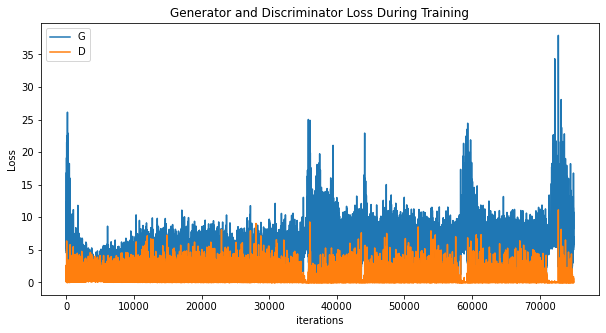

In [51]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Animation size has reached 21421769 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


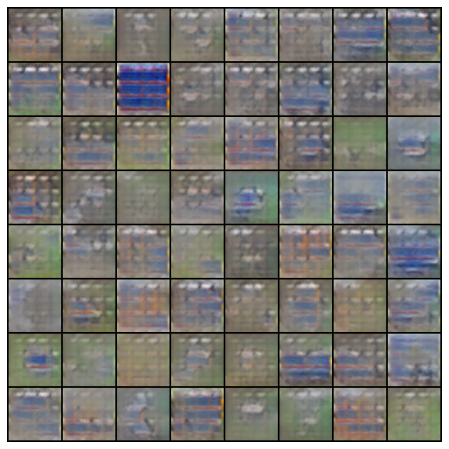

In [52]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

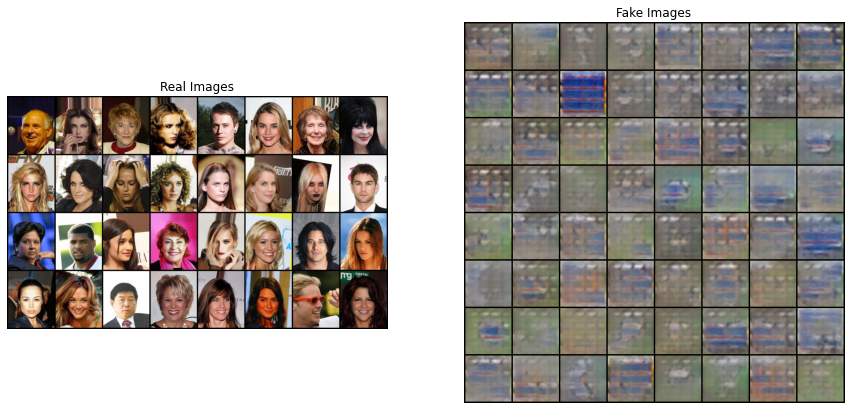

In [53]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(trainloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()